In [1]:
import numpy as np
from numpy import nan
from catboost import CatBoostRegressor, Pool, EFstrType, CatBoostClassifier
import pandas as pd
from lifelines.statistics import sample_size_necessary_under_cph , KaplanMeierFitter


In [2]:
ex1 = pd.read_csv('table_ml.csv' )
ex = pd.read_csv('table_ml_may21.csv' )

In [3]:
#set(ex.columns.values) - set(ex1.columns.values)

In [4]:
ex = ex[ex.covid_adm == 1]

## Estabilized inverse probability-of-treatment weights
### Estimating treatment propensity scores 
estimating propensity scores by fitting ML model with the treatment indicator as
the dependent variable and other covariates measured
before the treatment assignment as the independent
variables. Although there is no consensus as to which
covariates to include in the logistic model, in most circumstances,
it is appropriate to include all measured pretreatment
baseline characteristics regardless if they are
balanced or not between the two groups. Including posttreatment
characteristics in this model should be
considered with great caution and should be included
only if they are not affected by the treatment

### Select independent variables

In [5]:
drop = ['Anakinra',
 'Azitromicina',
 'Baricitinib',
 'Bemiparina',
 'Ciclosporina',
 'Cloroquina',
 'Convalescent_plasma',
 'Corticoides',
 'Darunavir_cobicistat',
 'Dexametasona ',
 'Eculizumab',
 'Enoxaparina',
 'Fosamprenavir',
 'G-CSF',
 'Heparina',
 'Hidroxicloroquina',
 'Inmunoglobulinas',
 'Interferon_beta_1a',
 'Interferon_beta_1b',
 'Ivermectina',
 'Lopinavir_ritonavir',
 'Metilprednisolona',
 'Remdesivir',
 'Ruxolitinib',
 'Sarilumab',
 'Siltuximab',
 'Tacrolimus',
 'Tiamina_vitamina_B1',
 'Tocilizumab',
 'Tofacitinib',
 'Vitamina_C',
 'Vitamina_D',
 'Zinc',]

In [6]:

drop1 = ['covid_adm', 'dx', '_patient_id', 'covid_rel_dx', 'tx_bin','tx_set', 'tx_set_string']


In [7]:
tt = 'Remdesivir'
substring_list = ['_mean', '_bin_', '_n_', '_total_' , 'delta', 'last', 'worst', '14', '28', f'{tt}']
#substring_list.extend(drop) #removed all ttos
leak_temp = [x for x in ex.columns.values if x.startswith('n_') or any(substring in x for substring in substring_list)]
leak_temp[:10]

['n_days_in',
 'n_covid_rel_dx',
 'n_covid_rel_image',
 'n_PCRs_+',
 'n_days_icu',
 'Hypogluc_delta',
 'Remdesivir',
 'n_PCRs',
 'n_days_to_ICU',
 'n_days_to_death']

In [116]:
#contains array, day and number is > 1, 
leak_tx_effect = [x for x in ex.columns.values if ('array' in x ) or (('day' in x and '_1' not in x) and ('day' in x and '_2' not in x) and  ('day' in x and '_3' not in x))]
leak_tx_effect[:5]

['n_days_in',
 'n_days_icu',
 'n_days_to_ICU',
 'n_days_to_death',
 'n_days_to_lastFU']

In [9]:
substring_list = ['critic','severity', 'dischar', 'survival', 'dead', 'readmi', 'survival_uncensored' ]
outcomes = [x for x in ex.columns.values if any(substring in x for substring in substring_list)]
outcomes

['critic',
 'severity',
 '_discharge',
 'n_days_to_readmission',
 'dead',
 'survival',
 'survival_uncensored',
 'readmission',
 'readmission_free_survival']

In [10]:
substring_list = ['glasgow','sofa', 'icu', 'ICU']
icu = [x for x in ex.columns.values if any(substring in x for substring in substring_list)]
icu[:10]

['n_days_icu',
 'sofa_scale',
 'glasgow',
 'date_icu_in',
 'glasgow_scale',
 'n_days_to_ICU',
 'cx_res_day_ICU_satO2',
 'cx_res_day_ICU_fiO2',
 'cx_res_day_ICU_resp_rate',
 'cx_res_day_ICU_SF_ratio']

In [11]:
x_vars = list(set(ex.columns.values) - set(icu)  - set(leak_tx_effect) - set(outcomes) - set(leak_temp) - set(drop) - set(drop1))
x_vars.sort()
x_vars[:10]

['1Diabetes',
 '2Diabetes',
 'ARDS',
 'Acute_bronchitis',
 'Acute_kidney',
 'CNS_cognitive',
 'CNS_ischemia',
 'Cardiovascular',
 'Covid_pneumonia',
 'Covid_rel_dx_binary']

### Transforms independent variables

In [12]:
ex.date_in = ex.date_in.apply(lambda x: (pd.to_datetime(x) - pd.to_datetime('2020-01-01')).days)

In [13]:
ex.covid_rel_image = ex.n_covid_rel_image.apply(lambda x: 1 if  x >= 1 else 0) #1 if any cultive + in first 3 days
ex.covid_rel_image.describe()

count    8971.000000
mean        0.509754
std         0.499933
min         0.000000
25%         0.000000
50%         1.000000
75%         1.000000
max         1.000000
Name: covid_rel_image, dtype: float64

In [14]:
ex.micro = ex.micro_delta.apply(lambda x: 1 if  x <=3 else 0) #1 if any cultive + in first 3 days
ex.micro.describe()

count    8971.000000
mean        0.030543
std         0.172085
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: micro, dtype: float64

In [15]:
ex['Hypogluc'] = ex.apply(lambda x: x.Hypogluc_grade if  x.Hypogluc_delta <=3 else 0, axis = 1) #1 if any hypogluc  in first 3 days
ex.Hypogluc.describe()

count    8971.000000
mean        0.004793
std         0.091314
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         2.000000
Name: Hypogluc, dtype: float64

In [16]:
pd.set_option('display.max_rows', None)
missing_df = pd.DataFrame((ex.isna().sum() * 100)/ ex.shape[0] ).reset_index()
missing_df.columns = ['name', 'perc']
missing_df[missing_df.perc > 60].head()

,name,perc
14,sofa_scale,98.651209
15,glasgow,100.000000
53,Hypogluc_delta,99.152826
86,date_icu_in,89.087058
88,glasgow_scale,96.477539


### Experiment: 
####  IP weighting:
1. Estimates selection to treatment (treatment model)
2. Predicts treatment for all observations
3. Assigns the inverse of probability of treatment for treated individuals AND the inverse
probability of not being treated for control individuals
4. Re-estimates the outcome model using these new weight

In [17]:
y_vars = ex[['tx_bin_Remdesivir']]
y_vars['tx'] = 0
y_vars.loc[y_vars['tx_bin_Remdesivir'] == True, ['tx']]  = 1
y_vars = y_vars.tx
y_vars[:10]

<ipython-input-17-af9ddcb72976>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y_vars['tx'] = 0
/home/auri/anaconda3/envs/bokeh/lib/python3.8/site-packages/pandas/core/indexing.py:1720: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


0     0
1     0
2     0
3     0
6     0
7     0
8     0
9     0
10    0
11    0
Name: tx, dtype: int64

In [18]:
x_vars.index('_gender')

34

In [19]:
X = ex[x_vars]

y = y_vars.values

In [20]:
X.shape, y.shape

((8971, 376), (8971,))

In [21]:
y.mean()

0.05907925537844164

### Cross Validation

In [22]:
from catboost import cv

In [23]:
cv_dataset = Pool(data = X, 
                 label = y,
                 cat_features=['_gender'])

In [24]:
params = {"iterations": 50,
          "depth": 6,
          'learning_rate' : 0.3,
          "loss_function": "CrossEntropy",
          "eval_metric": "AUC",
          "verbose": False}

In [25]:
scores = cv(cv_dataset,
            params,
            fold_count=10, 
            plot="True")

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

### Non- CV - Best Model

In [26]:
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.20, random_state=42)

In [27]:
#initialize Pool
train_pool = Pool(X_train, 
                  y_train, 
                  cat_features=['_gender'])
val_pool = Pool(X_val, 
                y_val, 
                cat_features=['_gender'])

all_pool = Pool(X, 
                y, 
                cat_features=['_gender'])

In [28]:
# specify the training parameters 
model = CatBoostClassifier(depth=6, 
                          iterations = 200,
                          learning_rate=0.3, 
                          loss_function='CrossEntropy', 
                          eval_metric='AUC'
                          )
#train the model
#early_stopping_rounds=20, 
model.fit(train_pool, eval_set=val_pool, plot = True, verbose = False, use_best_model=True)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [29]:
print(model.get_best_iteration())

71


In [30]:
print(model.get_all_params())
best_score = model.get_best_score()
print(best_score)
best_score['validation']['AUC']
auc = best_score['validation']['AUC']

{'nan_mode': 'Min', 'eval_metric': 'AUC', 'combinations_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1', 'Counter:CtrBorderCount=15:CtrBorderType=Uniform:Prior=0/1'], 'iterations': 200, 'sampling_frequency': 'PerTree', 'fold_permutation_block': 0, 'leaf_estimation_method': 'Newton', 'counter_calc_method': 'SkipTest', 'grow_policy': 'SymmetricTree', 'penalties_coefficient': 1, 'boosting_type': 'Plain', 'model_shrink_mode': 'Constant', 'feature_border_type': 'GreedyLogSum', 'ctr_leaf_count_limit': 18446744073709551615, 'bayesian_matrix_reg': 0.10000000149011612, 'one_hot_max_size': 2, 'l2_leaf_reg': 3, 'random_strength': 1, 'rsm': 1, 'boost_from_average': False, 'max_ctr_complexity': 4, 'model_size_reg': 0.5, 'simple_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1', 'Counter:CtrBorderCount=15:CtrBorderType=Uniform

In [31]:

model.save_model(f'ex_Remdemsivir_excluded_all_tto_AUC={auc}',
           format="cbm",
           export_parameters=None,
           pool=train_pool)

In [32]:
p_val = model.predict(val_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)

In [33]:
p_all_obervations = model.predict(all_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)


In [34]:
y  = np.expand_dims(y, axis=1)

In [35]:
matrix_p = np.concatenate( (y,p_all_obervations), axis = 1)
matrix_p

array([[0.00000000e+00, 9.99926440e-01, 7.35601465e-05],
       [0.00000000e+00, 9.96455815e-01, 3.54418496e-03],
       [0.00000000e+00, 9.91599492e-01, 8.40050758e-03],
       ...,
       [0.00000000e+00, 9.91756251e-01, 8.24374947e-03],
       [0.00000000e+00, 9.95404931e-01, 4.59506864e-03],
       [0.00000000e+00, 9.98734030e-01, 1.26597038e-03]])

In [36]:
matrix_p[:, 0] == 1

array([False, False, False, ..., False, False, False])

In [37]:
#marginal probability of being treated
marginal_p_t = y.mean()

# stabilized inverse probability-of-treatment weights (sIPTW): defined as the ratio of the marginal probability of being
# treated to the propensity score 
# generate the inverse probability weights as P(T=1|covariates) if T = 1 (Treatment = Y), and 1-P(T=1|covariates) if T = 0 (Treatment = N)
IPTW = np.where(matrix_p[:, 0] == 0 ,matrix_p[:, 1], matrix_p[:, 2]) 
sIPTW = marginal_p_t / IPTW
from scipy import stats
print(stats.describe(sIPTW), stats.describe(1/IPTW))

DescribeResult(nobs=8971, minmax=(0.059080239332841344, 14.617312320342604), mean=0.07438142763019652, variance=0.03917522621393951, skewness=49.54187855837687, kurtosis=3341.40466335004) DescribeResult(nobs=8971, minmax=(1.0000166548206033, 247.41869589772358), mean=1.2590109193782886, variance=11.223840518371915, skewness=49.54187855837688, kurtosis=3341.4046633500407)


In [38]:
list(zip(sIPTW, y,p_all_obervations))[:10]

[(0.059083601576826475, array([0]), array([9.99926440e-01, 7.35601465e-05])),
 (0.05928938793551772, array([0]), array([0.99645582, 0.00354418])),
 (0.05957975556646269, array([0]), array([0.99159949, 0.00840051])),
 (0.06017760718700234, array([0]), array([0.98174816, 0.01825184])),
 (0.059598874227466014, array([0]), array([0.9912814, 0.0087186])),
 (0.05918146505505854, array([0]), array([0.99827294, 0.00172706])),
 (0.05950720394849603, array([0]), array([0.99280846, 0.00719154])),
 (0.05920659113639108, array([0]), array([0.9978493, 0.0021507])),
 (0.05921190461614383, array([0]), array([0.99775975, 0.00224025])),
 (0.059705094899535315, array([0]), array([0.98951782, 0.01048218]))]

In [39]:
ex['sIPTW'] = sIPTW


In [40]:
list(zip(y_val,p_val))[:10]

[(0, array([0.95811205, 0.04188795])),
 (0, array([9.99256950e-01, 7.43049966e-04])),
 (0, array([0.98901607, 0.01098393])),
 (0, array([0.99346392, 0.00653608])),
 (0, array([0.9943429, 0.0056571])),
 (0, array([0.99864017, 0.00135983])),
 (0, array([0.99643616, 0.00356384])),
 (0, array([9.99019236e-01, 9.80764050e-04])),
 (0, array([0.9917948, 0.0082052])),
 (0, array([0.9988, 0.0012]))]

In [41]:
from catboost.utils import eval_metric
from math import log

labels = False
probabilites = False

val = True
if val:
    labels = y_val[:]

    probabilities = p_val[:,1]
#else: 
   # labels = y_test[:,0]
    
   # probabilities = p_test[:,1]
    
print(labels.shape)
print(probabilities.shape)

# In binary classification it is necessary to apply the logit function
# to the probabilities to get approxes.

logit = lambda x: log(x / (1 - x))
approxes = list(map(logit, probabilities))

accuracy = eval_metric(labels, approxes, 'Kappa')
accuracy

(1795,)
(1795,)


[0.26767730991389505]

In [42]:
importances = model.get_feature_importance(data=None,
                       type=EFstrType.FeatureImportance,
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

In [43]:
importances[:50]

,Feature Id,Importances
0,date_in,9.090282
1,tx_day_3_Cloroquina,7.393805
2,tx_day_3_Enoxaparina,6.649925
3,_health_dep,6.188224
4,tx_day_2_Hidroxicloroquina,3.996585
5,tx_day_3_Dexametasona,3.748414
6,tx_day_3_Darunavir_cobicistat,3.382602
7,_age,3.173852
8,Covid_respiratory_pneu,1.935365
9,tx_day_3_Baricitinib,1.850726


In [44]:
import shap

In [45]:
# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(X)

In [46]:
shap_values

.values =
array([[ 0.        , -0.03877396,  0.        , ..., -0.02959438,
         0.18416586,  0.        ],
       [ 0.        , -0.03367356,  0.        , ...,  0.01278891,
         0.07863923,  0.        ],
       [ 0.        ,  0.17079453,  0.        , ...,  0.01278891,
         0.09482366,  0.        ],
       ...,
       [ 0.        , -0.0302843 ,  0.        , ...,  0.00343701,
        -0.26204892,  0.        ],
       [ 0.        , -0.07536802,  0.        , ...,  0.01278891,
         0.10125546,  0.        ],
       [ 0.        ,  0.0071097 ,  0.        , ...,  0.01278891,
        -0.16465304,  0.        ]])

.base_values =
array([-4.64203052, -4.64203052, -4.64203052, ..., -4.64203052,
       -4.64203052, -4.64203052])

.data =
array([[0.0, 0.0, 0.0, ..., 3, 7, 7],
       [0.0, 0.0, 0.0, ..., 3, 4, 4],
       [0.0, 1.0, 0.0, ..., 3, 4, 4],
       ...,
       [0.0, 0.0, 0.0, ..., 3, 3, 3],
       [0.0, 0.0, 0.0, ..., 3, 4, 5],
       [0.0, 0.0, 0.0, ..., 3, 3, 3]], dtype=object)

In [47]:
y[10]

array([0])

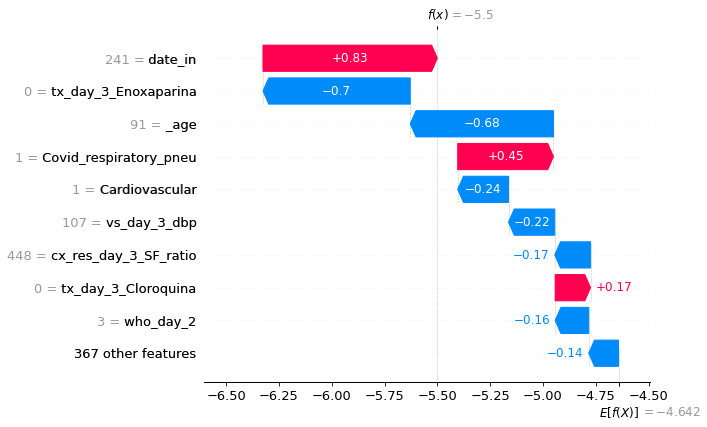

In [48]:
# visualize the first prediction's explanation
shap.plots.waterfall(shap_values[10])

In [49]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[10])

In [50]:
pd.DataFrame( {'feature' : X.columns.values, 'value' : shap_values[10].data})[:10]

,feature,value
0,1Diabetes,0.0
1,2Diabetes,0.0
2,ARDS,0.0
3,Acute_bronchitis,0.0
4,Acute_kidney,0.0
5,CNS_cognitive,0.0
6,CNS_ischemia,0.0
7,Cardiovascular,1.0
8,Covid_pneumonia,True
9,Covid_rel_dx_binary,1


In [51]:
# visualize all the training set predictions
shap.initjs()
shap.plots.force(explainer.expected_value, shap_values.values[:500], feature_names = X.columns)

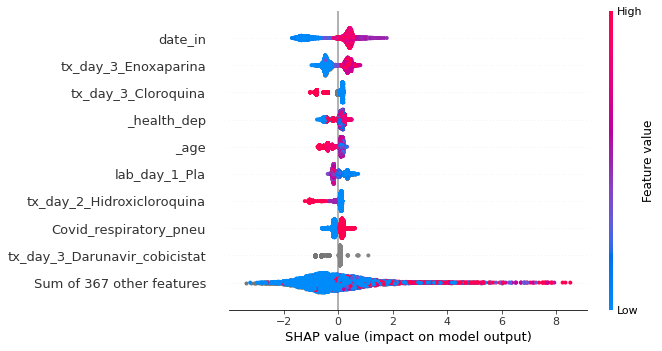

In [52]:
shap.plots.beeswarm(shap_values)

Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.


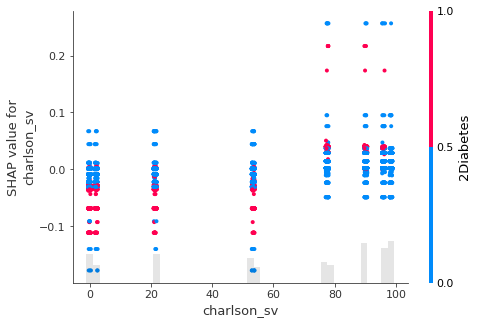

In [53]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,'charlson_sv'], color=shap_values)

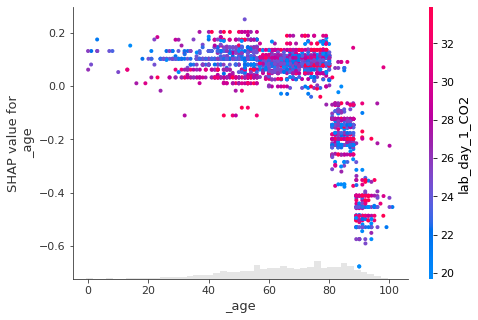

In [54]:
shap.plots.scatter(shap_values[:,'_age'], color=shap_values)

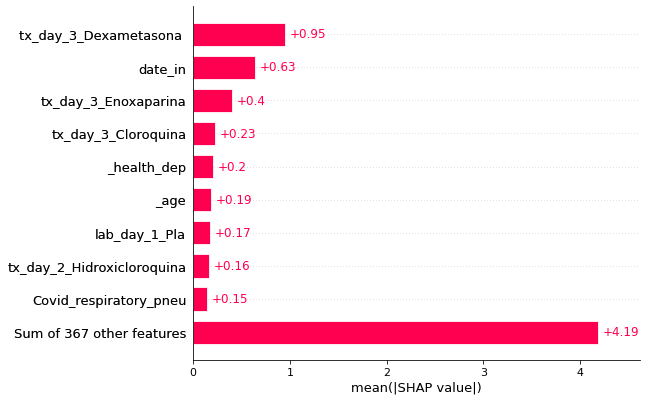

In [55]:
shap.plots.bar(shap_values)

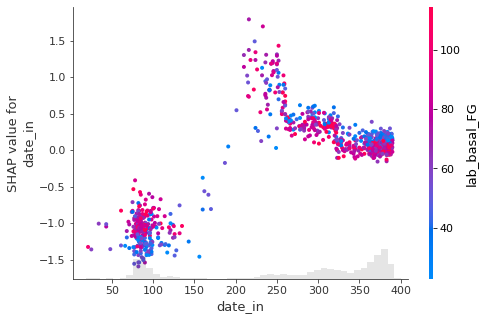

In [56]:
shap.plots.scatter(shap_values[:,'date_in'], color=shap_values)

In [57]:
interactions = model.get_feature_importance(data=None,
                       type=EFstrType.Interaction,
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

In [58]:
interactions['First Feature'] = interactions['First Feature Index'].apply(lambda x: x_vars[x])
interactions['Second Feature'] = interactions['Second Feature Index'].apply(lambda x: x_vars[x])

In [59]:
interactions[['First Feature', 'Second Feature', 'Interaction']].iloc[:10]

,First Feature,Second Feature,Interaction
0,_health_dep,date_in,1.151835
1,Covid_respiratory_pneu,date_in,1.146039
2,tx_day_2_Ciclosporina,tx_day_2_Tiamina_vitamina_B1,0.813309
3,lab_day_2_T8,tx_day_3_Baricitinib,0.684244
4,index,tx_day_2_Dexametasona,0.658499
5,lab_day_1_SBE,tx_day_3_Baricitinib,0.628859
6,tx_day_3_Cloroquina,tx_day_3_Dexametasona,0.628780
7,tx_day_2_Hidroxicloroquina,tx_day_2_Tiamina_vitamina_B1,0.546065
8,tx_day_2_Baricitinib,tx_day_2_Hidroxicloroquina,0.542467
9,tx_day_1_Dexametasona,tx_day_2_Baricitinib,0.534169


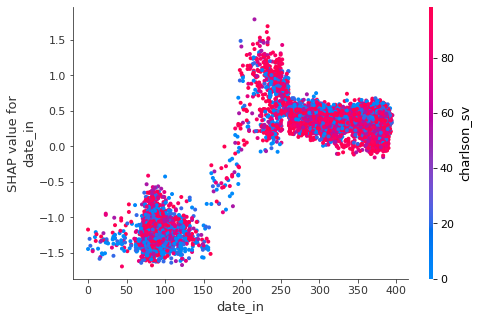

In [60]:
shap.dependence_plot("date_in", shap_values.values, X, interaction_index= 'charlson_sv')

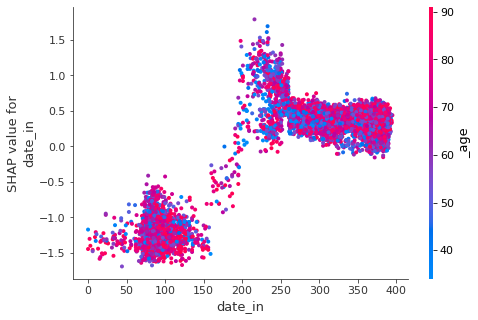

In [61]:
shap.dependence_plot("date_in", shap_values.values, X, interaction_index= '_age')

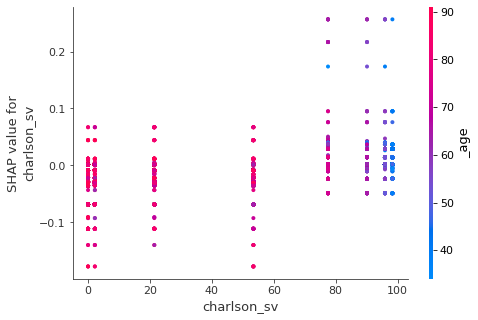

In [62]:
shap.dependence_plot("charlson_sv", shap_values.values, X, interaction_index= '_age')

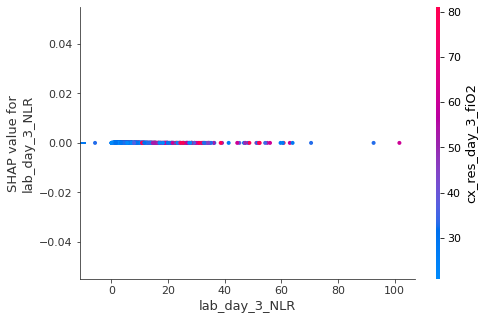

In [63]:
shap.dependence_plot("lab_day_3_NLR", shap_values.values, X, interaction_index= 'cx_res_day_3_fiO2')

from pathlib import Path
path_rx = Path('../Rx-thorax-automatic-captioning')
img_labels = pd.read_csv(path_rx /'Labels_covid_pharma.csv')[['PatientID','ReportID','Report','Labels', 'LabelsLocalizationsBySentence', 'labelCUIS', 'LocalizationsCUIS']]
img_labels['_health_dep'] = img_labels.ReportID.apply(lambda x: x.split('_')[0])
img_labels['_date'] = img_labels.ReportID.apply(lambda x: x.split('_')[-1])
img_labels['_modality'] = img_labels.ReportID.apply(lambda x: x.split('_')[-2])
img_labels.drop(columns = ['ReportID'], inplace = True)

img_labels[img_labels._health_dep == '20'].to_csv('Rx_20.csv', index = False)


img_labels[img_labels._health_dep == '20'].shape

#### Generate adusted sv curves

In [64]:
from lifelines import KaplanMeierFitter, CoxPHFitter
from lifelines.statistics import logrank_test
import seaborn as sns
import matplotlib.pyplot as plt

suffix_csv = '.csv'
suffix_png = f'.png'

def sv_tx_graph(df_select,tx,  log, group = np.array([])):
    
    km_df = df_select  
    
    km_df = km_df[(km_df.survival < 600 ) & (km_df.survival >= 0 )]
    print(km_df.shape)
    if group.size == 0:
        group = km_df[f'tx_bin_{tx}'] == True
    else:
        group = km_df.index.isin(group)

    col =  ['charlson','charlson_sv','_age' ]
    d = pd.DataFrame(km_df.groupby(group).describe(), ).sort_index(ascending = False).round(1).loc[:,(col,['mean','std'])]


    kmf = KaplanMeierFitter()
    if log:
        X= km_df['survival'].apply(lambda x: np.log2(x) if x > 0 else x)
    else: 
        X= km_df['survival']
    Y = km_df.apply(lambda x: False if (x.dead == True) and  (x.readmission == True) else x['dead'] ,axis = 1)  #do not count as dead if the event belong to a future readmission 
    #Y = km_df['dead']
    ax = plt.subplot(111)
    kmf.fit(X[group], event_observed = Y[group], label = f'{tx} (n {X[group].shape[0]}, Age {d[["_age"]].iloc[0].values[0]}y)',
           weights = km_df[group].sIPTW)
    kmf.plot(ax = ax)
    kmf.fit(X[~group], event_observed = Y[~group], label = f'No {tx} (n {X[~group].shape[0]}, Age {d[["_age"]].iloc[1].values[0]}y)',
           weights = km_df[~group].sIPTW)
    kmf.plot(ax = ax)
    plt.title("Kaplan Meier estimates")
    plt.xlabel("Days after admission")
    plt.ylabel("Survival")
    plt.legend(fontsize = 'x-small')
    if log:
        plt.xticks([0,2,4,6,8],[0,4,16,64,256])

    if log: 
        plt.savefig(f'out_EDA/STATS/adjusted_KM_sv_{tx}_log_scaled_{suffix_png}')
    else: 
        plt.savefig(f'out_EDA/STATS/adjusted_KM_sv_{tx}_{suffix_png}')
    #plt.show()
    
    
    # Define variables :
    T=X[group]
    E=Y[group]
    T1=X[~group]
    E1=Y[~group]

    from lifelines.statistics import logrank_test

    results=logrank_test(T,T1,event_observed_A=E, event_observed_B=E1)
    results.print_summary()
    
    
    from lifelines import CoxPHFitter

    df = km_df[['survival','dead','sIPTW',f'tx_bin_{tx}','charlson_sv', '_age']]

    cph = CoxPHFitter()
    cph.fit(df, 'survival', 'dead',  robust=True, weights_col='sIPTW')
    cph.print_summary()
    return

(8969, 1085)


It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  
It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
          19.69 <0.005     16.74

<lifelines.CoxPHFitter: fitted with 667.157 total observations, 560.379 right-censored observations>
             duration col = 'survival'
                event col = 'dead'
              weights col = 'sIPTW'
          robust variance = True
      baseline estimation = breslow
   number of observations = 667.157
number of events observed = 106.778
   partial log-likelihood = -596.38
         time fit was run = 2021-06-02 08:18:52 UTC

---
                    coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                                 
tx_bin_Remdesivir  -0.35       0.71       0.27            -0.87             0.17                 0.42                 1.19
charlson_sv        -0.01       0.99       0.00            -0.01            -0.01                 0.99                 0.99
_age                0.05       1.05       0.01             0.04             0.06                 1.04                 1.06

                      z      p   -log2(p)
covariate                                
tx_bin_Remdesivir -1.30   0.19       2.38
charlson_sv       -4.64 <0.005      18.10
_age               8.81 <0.005      59.48
---
Concordance = 0.77
Partial AIC = 1198.76
log-likelihood ratio test = 91.20 on 3 df
-log2(p) of ll-ratio test = 62.84

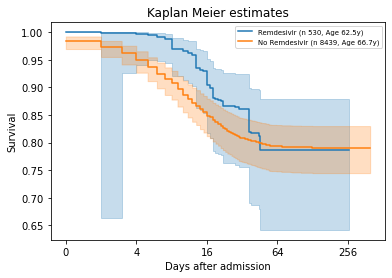

In [65]:
sv_tx_graph(ex, 'Remdesivir', log = True )

### Re-estimates the outcome model using these new weight sIPTW

#### Outcome: AUC of the models for predicting mortality conditioned on treatment as a binomial outcome treatment responsiveness was predicted through a binomial logistic objective that was used for predicting positive class (improved disease if treated vs worsened disease if not treated) and negative class (worsened disease if treated vs improved disease if not treated). For our purposes, improved disease was defined as a last recorded oxygen saturation of ≥95%, or survival (defined as discharged alive), and worsened disease was defined as a last recorded oxygen saturation of < 95%, or death.

###### Remove all variables beyond 1º day of admission in the training set

In [66]:
substring_list = ['critic','severity', 'dischar', 'survival', 'dead', 'readmi', 'survival_uncensored' ]
outcomes = [x for x in ex.columns.values if any(substring in x for substring in substring_list)]
outcomes.extend(['cx_res_day_last_satO2', 'who_last','who_array', 'who_bin',  'weight', 'who_day_2'])


In [67]:
ex[outcomes].head()

,critic,severity,_discharge,n_days_to_readmission,dead,survival,survival_uncensored,readmission,readmission_free_survival,cx_res_day_last_satO2,who_last,who_array,who_bin,weight,who_day_2
0,True,5,exitus,NaN,True,1,1,False,1,90.0,7,[3 7 7],True,NaN,7
1,False,3,equipo atencion primaria,NaN,False,238,400,False,238,94.0,1,[3 4 4 4 4 5 4 1 1],True,NaN,4
2,False,2,equipo atencion primaria,NaN,False,37,400,False,37,93.0,1,[3 4 4 1 1],True,NaN,4
3,True,5,exitus,NaN,True,7,7,False,11,50.0,7,[3 4 4 5 4 4 4 7 7],True,NaN,4
6,False,3,equipo atencion primaria,NaN,False,62,400,False,62,94.0,5,[3 4 4 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5...,True,NaN,4


In [68]:
beyond_1_day_list = ['2_','3', '4_', '5_', '6', '7', '8_', '9' ]
beyond_1_day = [x for x in ex.columns.values if any(substring in x for substring in beyond_1_day_list)]
ex[beyond_1_day].head()

,tx_day_2_Anakinra,tx_day_3_Anakinra,tx_day_2_Azitromicina,tx_day_3_Azitromicina,tx_day_2_Baricitinib,tx_day_3_Baricitinib,tx_day_2_Bemiparina,tx_day_3_Bemiparina,tx_day_2_Ciclosporina,tx_day_3_Ciclosporina,...,lab_day_7_pH,lab_day_2_pO2,lab_day_3_pO2,lab_day_4_pO2,lab_day_5_pO2,lab_day_6_pO2,lab_day_7_pO2,who_day_3,who_day_6,who_day_7
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,7,7
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,5,4
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,1,1
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,65.4,NaN,4,4,4
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,5,5


In [69]:
x_vars = list(set(ex.columns.values) - set(['date_in']) - set(beyond_1_day) - set(icu)  - set(leak_tx_effect) - set(outcomes) - set(leak_temp) - set(drop) - set(drop1))
x_vars.sort()
x_vars

['1Diabetes',
 '2Diabetes',
 'ARDS',
 'Acute_bronchitis',
 'Acute_kidney',
 'CNS_cognitive',
 'CNS_ischemia',
 'Cardiovascular',
 'Covid_pneumonia',
 'Covid_rel_dx_binary',
 'Covid_respiratory_interst',
 'Covid_respiratory_other',
 'Covid_respiratory_pneu',
 'Covid_respiratory_pneu_other',
 'Covid_respiratory_upp',
 'Cytokine_RS',
 'Disseminated_IC',
 'Enteritis',
 'Heart_disease',
 'Hypertension',
 'Hypogluc',
 'Hypogluc_grade',
 'Immunocompromised',
 'Inflammatory_R',
 'Lipemias',
 'Liver',
 'Lung_Embolism',
 'Malignancy',
 'Obesity',
 'Renal',
 'Respiratory',
 'Second_pneumonia',
 'Tobacco',
 'Venous_Thrombosis',
 '_age',
 '_gender',
 '_health_dep',
 'barthel_scale',
 'charlson',
 'charlson_sv',
 'covid_rel_image',
 'cx_res_basal_SF_ratio',
 'cx_res_basal_fiO2',
 'cx_res_basal_resp_rate',
 'cx_res_basal_satO2',
 'cx_res_day_1_SF_ratio',
 'cx_res_day_1_fiO2',
 'cx_res_day_1_resp_rate',
 'cx_res_day_1_satO2',
 'height',
 'index',
 'lab_basal_25',
 'lab_basal_ALB',
 'lab_basal_BNP',
 '

In [70]:
pd.set_option('display.max_columns', None)
#ex.head()

In [71]:
ex['cx_res_day_last_satO2'].describe()

count    8794.000000
mean       93.473896
std         6.975759
min         0.500000
25%        93.000000
50%        95.000000
75%        97.000000
max       100.000000
Name: cx_res_day_last_satO2, dtype: float64

#### Design improvement - No response to treatment outcome based in who scale: 1, not hospitalized with resumption of normal activities; 2, not hospitalized, but unable to resume normal activities; 3, hospitalized, not requiring supplemental oxygen; 4, hospitalized, requiring supplemental oxygen; 5, hospitalized, requiring nasal high-flow oxygen therapy, noninvasive mechanical ventilation, or both; 6, hospitalized, requiring ECMO, invasive mechanical ventilation, or both; and 7, death. Who >= 4 is a better surrogate of treatment not responsiveness than either satO2 on last day or death as satO2 has not into account if supplemental oxigen. 

In [72]:
ex['y_who'] = 1 #disease improved 
ex.loc[ex.who_last >= 4, ['y_who'] ] = 0
ex.y_who.describe()

count    8971.000000
mean        0.802921
std         0.397815
min         0.000000
25%         1.000000
50%         1.000000
75%         1.000000
max         1.000000
Name: y_who, dtype: float64

In [73]:
ex['y_binomial'] = 1 #disease improved and treated OR disease not improved and not treated 
ex.loc[(ex.y_who == 1) & (ex.tx_bin_Remdesivir == 0) , ['y_binomial'] ] = 0 #disease improved and not treated
ex.loc[(ex.y_who == 0) & (ex.tx_bin_Remdesivir == 1) , ['y_binomial'] ] = 0 #disease not improved and treated 
ex.y_binomial.describe()

count    8971.000000
mean        0.243451
std         0.429189
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: y_binomial, dtype: float64

In [74]:
y_binomial = ex.y_binomial.values
y_binomial

array([1, 0, 0, ..., 1, 1, 0])

In [75]:
X = ex[x_vars]
X.head()

,1Diabetes,2Diabetes,ARDS,Acute_bronchitis,Acute_kidney,CNS_cognitive,CNS_ischemia,Cardiovascular,Covid_pneumonia,Covid_rel_dx_binary,Covid_respiratory_interst,Covid_respiratory_other,Covid_respiratory_pneu,Covid_respiratory_pneu_other,Covid_respiratory_upp,Cytokine_RS,Disseminated_IC,Enteritis,Heart_disease,Hypertension,Hypogluc,Hypogluc_grade,Immunocompromised,Inflammatory_R,Lipemias,Liver,Lung_Embolism,Malignancy,Obesity,Renal,Respiratory,Second_pneumonia,Tobacco,Venous_Thrombosis,_age,_gender,_health_dep,barthel_scale,charlson,charlson_sv,covid_rel_image,cx_res_basal_SF_ratio,cx_res_basal_fiO2,cx_res_basal_resp_rate,cx_res_basal_satO2,cx_res_day_1_SF_ratio,cx_res_day_1_fiO2,cx_res_day_1_resp_rate,cx_res_day_1_satO2,height,index,lab_basal_25,lab_basal_ALB,lab_basal_BNP,lab_basal_Bic,lab_basal_Bil,lab_basal_CAL,lab_basal_CLO,lab_basal_CO2,lab_basal_CPK,lab_basal_Cre,lab_basal_Dim,lab_basal_ERI,lab_basal_Exc,lab_basal_FG,lab_basal_FIL,lab_basal_FOS,lab_basal_Fer,lab_basal_FiO,lab_basal_Fib,lab_basal_GGT,lab_basal_GLU,lab_basal_GOT,lab_basal_GPT,lab_basal_HEM,lab_basal_Hem,lab_basal_IL,lab_basal_K_o,lab_basal_LDH,lab_basal_LIN,lab_basal_Leu,lab_basal_MAG,lab_basal_MON,lab_basal_NEU,lab_basal_NLR,lab_basal_PCR,lab_basal_POT,lab_basal_PRO,lab_basal_Pla,lab_basal_Prc,lab_basal_Pre,lab_basal_SBE,lab_basal_SOD,lab_basal_Sat,lab_basal_T4,lab_basal_T8,lab_basal_TRO,lab_basal_TTP,lab_basal_Tra,lab_basal_URE,lab_basal_glu_cv,lab_basal_pCO,lab_basal_pH,lab_basal_pO2,lab_day_1_25,lab_day_1_ALB,lab_day_1_BNP,lab_day_1_Bic,lab_day_1_Bil,lab_day_1_CAL,lab_day_1_CLO,lab_day_1_CO2,lab_day_1_CPK,lab_day_1_Cre,lab_day_1_Dim,lab_day_1_ERI,lab_day_1_Exc,lab_day_1_FG,lab_day_1_FIL,lab_day_1_FOS,lab_day_1_Fer,lab_day_1_FiO,lab_day_1_Fib,lab_day_1_GGT,lab_day_1_GLU,lab_day_1_GOT,lab_day_1_GPT,lab_day_1_HEM,lab_day_1_Hem,lab_day_1_IL,lab_day_1_K_o,lab_day_1_LDH,lab_day_1_LIN,lab_day_1_Leu,lab_day_1_MAG,lab_day_1_MON,lab_day_1_NEU,lab_day_1_NLR,lab_day_1_PCR,lab_day_1_POT,lab_day_1_PRO,lab_day_1_Pla,lab_day_1_Prc,lab_day_1_Pre,lab_day_1_SBE,lab_day_1_SOD,lab_day_1_Sat,lab_day_1_T4,lab_day_1_T8,lab_day_1_TRO,lab_day_1_TTP,lab_day_1_Tra,lab_day_1_URE,lab_day_1_glu_cv,lab_day_1_pCO,lab_day_1_pH,lab_day_1_pO2,micro,sIPTW,tx_day_1_Anakinra,tx_day_1_Azitromicina,tx_day_1_Baricitinib,tx_day_1_Bemiparina,tx_day_1_Ciclosporina,tx_day_1_Cloroquina,tx_day_1_Corticoides,tx_day_1_Darunavir_cobicistat,tx_day_1_Dexametasona,tx_day_1_Enoxaparina,tx_day_1_G-CSF,tx_day_1_Heparina,tx_day_1_Hidroxicloroquina,tx_day_1_Interferon_beta_1a,tx_day_1_Interferon_beta_1b,tx_day_1_Ivermectina,tx_day_1_Lopinavir_ritonavir,tx_day_1_Metilprednisolona,tx_day_1_Ruxolitinib,tx_day_1_Tacrolimus,tx_day_1_Tiamina_vitamina_B1,tx_day_1_Tocilizumab,tx_day_1_Tofacitinib,tx_day_1_Vitamina_D,tx_day_1_Zinc,vs_basal_dbp,vs_basal_heart_rate,vs_basal_sbp,vs_basal_tem,vs_day_1_dbp,vs_day_1_heart_rate,vs_day_1_sbp,vs_day_1_tem,who_day_1
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True,1,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,91.0,woman,8,NaN,6.0,2.2,1,230.0,37.0,40.0,85.0,95.0,81.0,40.0,77.0,NaN,0,NaN,NaN,NaN,24.8,NaN,NaN,96.9,NaN,251.0,1.39,3268.58,2.72,0.4,35.0,35.0,NaN,NaN,0.0,606.48,NaN,112.0,51.6,18.7,NaN,9.7,NaN,NaN,279.0,0.77,49.97,NaN,0.80,48.24,62.65,307.8,6.23,NaN,211.0,2.31,NaN,NaN,130.8,84.0,NaN,NaN,NaN,37.2,NaN,101.0,NaN,41.5,7.39,52.8,NaN,NaN,NaN,24.8,NaN,NaN,96.9,NaN,251.0,1.39,3268.58,2.72,0.40,35.0,35.0,NaN,NaN,0.0,606.48,NaN,112.0,51.6,18.70,NaN,9.7,NaN,NaN,279.0,0.77,49.97,NaN,0.80,48.24,62.65,307.80,6.23,NaN,211.0,2.31,NaN,NaN,130.8,84.0,NaN,NaN,NaN,37.2,NaN,101.0,NaN,41.5,7.39,52.8,0,0.059084,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,40.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,48.0,78.0,97.0,36.7,48.0,89.0,84.0,36.7,3
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,True,1,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,woman,8,NaN,3.0,77.5,1,321.0,29.0,32.0,93.0,321.0,29.0,36.0,93

In [76]:
### Cross Validation


cv_dataset = Pool(data = X, 
                 label = y_binomial,
                 weight = sIPTW,
                 cat_features=['_gender'])

params = {"iterations": 50,
          "depth": 6,
          'learning_rate' : 0.3,
          "loss_function": "CrossEntropy",
          "eval_metric": "AUC",
          "verbose": False}

scores = cv(cv_dataset,
            params,
            fold_count=10, 
            plot="True")

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

from sklearn.utils import class_weight

class_w = class_weight.compute_class_weight(class_weight = 'balanced', classes= np.unique(y_vars), y =y_vars )
class_w

y_true = y_vars == 1
sIPTW[y_true == False].sum()

y_vars.max()

y_balanced = y_vars 
y_balanced = np.where(y_sIPTW == False, class_w[0], class_w[1])

y_weighted = y_balanced + sIPTW

y_weighted.max()

In [78]:
#x_vars.extend(['sIPTW'])


In [79]:
### Non- CV - Best Model

X_test = ex.loc[(ex._health_dep == 17), x_vars]
y_test = ex.loc[(ex._health_dep == 17), 'y_binomial'].values


X = ex.loc[(ex._health_dep != 17),x_vars]
y_binomial  = ex.loc[(ex._health_dep != 17),'y_binomial'].values

print(X.shape, y_binomial.shape,X_test.shape, y_test.shape, )

from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(
    X, y_binomial, test_size=0.20, random_state=42)


(7938, 193) (7938,) (1033, 193) (1033,)


In [80]:
x_vars.remove('sIPTW')


In [81]:


#initialize Pool
train_pool = Pool(X_train[x_vars], 
                  y_train, 
                  weight = X_train.sIPTW,
                  cat_features=['_gender'])
val_pool = Pool(X_val[x_vars], 
                y_val, 
                weight = X_val.sIPTW,
                cat_features=['_gender'])

test_pool = Pool(X_test, 
                y_test, 
                weight = X_test.sIPTW,
                cat_features=['_gender'])

# specify the training parameters 
model = CatBoostClassifier(depth=6, 
                          iterations = 200,
                          learning_rate=0.3, 
                          loss_function='CrossEntropy', 
                          eval_metric='AUC'
                          )
#train the model
#early_stopping_rounds=20, 
model.fit(train_pool, eval_set=val_pool, plot = True, verbose = False, use_best_model=True)


print(model.get_best_iteration())

print(model.get_all_params())
best_score = model.get_best_score()
print(best_score)
best_score['validation']['AUC']
auc = best_score['validation']['AUC']


model.save_model(f'ex_Remdemsivir_recommender_AUC={auc}',
           format="cbm",
           export_parameters=None,
           pool=train_pool)

p_val = model.predict(val_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)

p_test = model.predict(test_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

49
{'nan_mode': 'Min', 'eval_metric': 'AUC', 'combinations_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1', 'Counter:CtrBorderCount=15:CtrBorderType=Uniform:Prior=0/1'], 'iterations': 200, 'sampling_frequency': 'PerTree', 'fold_permutation_block': 0, 'leaf_estimation_method': 'Newton', 'counter_calc_method': 'SkipTest', 'grow_policy': 'SymmetricTree', 'penalties_coefficient': 1, 'boosting_type': 'Plain', 'model_shrink_mode': 'Constant', 'feature_border_type': 'GreedyLogSum', 'ctr_leaf_count_limit': 18446744073709551615, 'bayesian_matrix_reg': 0.10000000149011612, 'one_hot_max_size': 2, 'l2_leaf_reg': 3, 'random_strength': 1, 'rsm': 1, 'boost_from_average': False, 'max_ctr_complexity': 4, 'model_size_reg': 0.5, 'simple_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1', 'Counter:CtrBorderCount=15:CtrBorderType=Unif

In [82]:
list(zip(y_val,p_val))[:10], list(zip(y_test,p_test))[:10]

([(0, array([0.67480525, 0.32519475])),
  (1, array([0.87201964, 0.12798036])),
  (0, array([0.86411198, 0.13588802])),
  (0, array([0.76950756, 0.23049244])),
  (0, array([0.886623, 0.113377])),
  (0, array([0.94452712, 0.05547288])),
  (0, array([0.93365761, 0.06634239])),
  (1, array([0.6599477, 0.3400523])),
  (0, array([0.896058, 0.103942])),
  (0, array([0.82858799, 0.17141201]))],
 [(1, array([0.91741069, 0.08258931])),
  (0, array([0.98402094, 0.01597906])),
  (0, array([0.96973561, 0.03026439])),
  (0, array([0.89433095, 0.10566905])),
  (0, array([0.94829649, 0.05170351])),
  (1, array([0.98394123, 0.01605877])),
  (1, array([0.55361393, 0.44638607])),
  (0, array([0.67723707, 0.32276293])),
  (0, array([0.88426653, 0.11573347])),
  (0, array([0.95343178, 0.04656822]))])

In [83]:
from catboost.utils import eval_metric
from math import log

labels = y_test
print(labels.shape)
probabilities = p_test[:,1]
print(probabilities.shape)

val = False
if val:
    labels = y_val[:,0]

    probabilities = p_val[:,1]


# In binary classification it is necessary to apply the logit function
# to the probabilities to get approxes.

logit = lambda x: log(x / (1 - x))
approxes = list(map(logit, probabilities))

accuracy = eval_metric(labels, approxes, 'AUC')
accuracy

(1033,)
(1033,)


[0.7098376533530117]

In [84]:
importances = model.get_feature_importance(data=None,
                       type=EFstrType.FeatureImportance,
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

In [85]:
importances[:20]

,Feature Id,Importances
0,cx_res_day_1_satO2,4.842158
1,cx_res_day_1_fiO2,3.533304
2,lab_basal_URE,3.105707
3,cx_res_day_1_SF_ratio,3.044168
4,_age,2.858687
5,lab_basal_PCR,2.572921
6,lab_day_1_GOT,2.530747
7,lab_basal_Fib,2.370317
8,lab_basal_Prc,2.152234
9,tx_day_1_Dexametasona,1.977936


In [86]:
interactions = model.get_feature_importance(data=None,
                       type=EFstrType.Interaction,
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

interactions['First Feature'] = interactions['First Feature Index'].apply(lambda x: x_vars[x])
interactions['Second Feature'] = interactions['Second Feature Index'].apply(lambda x: x_vars[x])

interactions[['First Feature', 'Second Feature', 'Interaction']].iloc[:10]

,First Feature,Second Feature,Interaction
0,cx_res_day_1_fiO2,lab_day_1_GLU,0.695244
1,cx_res_day_1_fiO2,cx_res_day_1_satO2,0.666342
2,tx_day_1_Baricitinib,tx_day_1_Bemiparina,0.574502
3,lab_basal_TTP,lab_basal_URE,0.572841
4,cx_res_day_1_fiO2,lab_day_1_TRO,0.529250
5,lab_basal_IL,lab_day_1_URE,0.523975
6,_age,tx_day_1_Baricitinib,0.519280
7,cx_res_day_1_satO2,vs_basal_sbp,0.488984
8,cx_res_day_1_resp_rate,lab_basal_CPK,0.482584
9,charlson,lab_basal_Pla,0.457853


In [117]:
ex.loc[(ex.cx_res_day_1_SF_ratio == 0)]

,index,_patient_id,_health_dep,_age,_gender,date_in,n_days_in,barthel_scale,n_covid_rel_dx,covid_rel_dx,n_covid_rel_image,covid_rel_image,n_PCRs_+,n_days_icu,sofa_scale,glasgow,critic,severity,_discharge,1Diabetes,2Diabetes,ARDS,Acute_bronchitis,Acute_kidney,Anakinra,Azitromicina,Baricitinib,Bemiparina,CNS_cognitive,CNS_ischemia,Cardiovascular,Ciclosporina,Cloroquina,Convalescent_plasma,Corticoides,Covid_respiratory_interst,Covid_respiratory_other,Covid_respiratory_pneu,Covid_respiratory_pneu_other,Covid_respiratory_upp,Cytokine_RS,Darunavir_cobicistat,Dexametasona,Disseminated_IC,Eculizumab,Enoxaparina,Enteritis,Fosamprenavir,G-CSF,Heart_disease,Heparina,Hidroxicloroquina,Hypertension,Hypogluc_delta,Hypogluc_grade,Immunocompromised,Inflammatory_R,Inmunoglobulinas,Interferon_beta_1a,Interferon_beta_1b,Ivermectina,Lipemias,Liver,Lopinavir_ritonavir,Lung_Embolism,Malignancy,Metilprednisolona,Obesity,Remdesivir,Renal,Respiratory,Ruxolitinib,Sarilumab,Second_pneumonia,Siltuximab,Tacrolimus,Tiamina_vitamina_B1,Tobacco,Tocilizumab,Tofacitinib,Venous_Thrombosis,Vitamina_C,Vitamina_D,Zinc,charlson,charlson_sv,date_icu_in,dx,glasgow_scale,height,micro,n_PCRs,n_days_to_ICU,n_days_to_death,n_days_to_lastFU,n_days_to_readmission,n_image,weight,tx_bin,tx_set,tx_array_Anakinra,tx_bin_Anakinra,tx_dose_total_Anakinra,tx_day_1_Anakinra,tx_day_2_Anakinra,tx_day_3_Anakinra,tx_delta_init_Anakinra,tx_total_days_Anakinra,tx_array_Azitromicina,tx_bin_Azitromicina,tx_dose_total_Azitromicina,tx_day_1_Azitromicina,tx_day_2_Azitromicina,tx_day_3_Azitromicina,tx_delta_init_Azitromicina,tx_total_days_Azitromicina,tx_array_Baricitinib,tx_bin_Baricitinib,tx_dose_total_Baricitinib,tx_day_1_Baricitinib,tx_day_2_Baricitinib,tx_day_3_Baricitinib,tx_delta_init_Baricitinib,tx_total_days_Baricitinib,tx_array_Bemiparina,tx_bin_Bemiparina,tx_dose_total_Bemiparina,tx_day_1_Bemiparina,tx_day_2_Bemiparina,tx_day_3_Bemiparina,tx_delta_init_Bemiparina,tx_total_days_Bemiparina,tx_array_Ciclosporina,tx_bin_Ciclosporina,tx_dose_total_Ciclosporina,tx_day_1_Ciclosporina,tx_day_2_Ciclosporina,tx_day_3_Ciclosporina,tx_delta_init_Ciclosporina,tx_total_days_Ciclosporina,tx_array_Cloroquina,tx_bin_Cloroquina,tx_dose_total_Cloroquina,tx_day_1_Cloroquina,tx_day_2_Cloroquina,tx_day_3_Cloroquina,tx_delta_init_Cloroquina,tx_total_days_Cloroquina,tx_array_Convalescent_plasma,tx_array_Corticoides,tx_dose_total_Corticoides,tx_day_1_Corticoides,tx_day_2_Corticoides,tx_day_3_Corticoides,tx_delta_init_Corticoides,tx_total_days_Corticoides,tx_array_Darunavir_cobicistat,tx_bin_Darunavir_cobicistat,tx_dose_total_Darunavir_cobicistat,tx_day_1_Darunavir_cobicistat,tx_day_2_Darunavir_cobicistat,tx_day_3_Darunavir_cobicistat,tx_delta_init_Darunavir_cobicistat,tx_total_days_Darunavir_cobicistat,tx_array_Dexametasona,tx_dose_total_Dexametasona,tx_day_1_Dexametasona,tx_day_2_Dexametasona,tx_day_3_Dexametasona,tx_delta_init_Dexametasona,tx_total_days_Dexametasona,tx_array_Eculizumab,tx_array_Enoxaparina,tx_bin_Enoxaparina,tx_dose_total_Enoxaparina,tx_day_1_Enoxaparina,tx_day_2_Enoxaparina,tx_day_3_Enoxaparina,tx_delta_init_Enoxaparina,tx_total_days_Enoxaparina,tx_array_Fosamprenavir,tx_array_G-CSF,tx_bin_G-CSF,tx_dose_total_G-CSF,tx_day_1_G-CSF,tx_day_2_G-CSF,tx_day_3_G-CSF,tx_delta_init_G-CSF,tx_total_days_G-CSF,tx_array_Heparina,tx_bin_Heparina,tx_dose_total_Heparina,tx_day_1_Heparina,tx_day_2_Heparina,tx_day_3_Heparina,tx_delta_init_Heparina,tx_total_days_Heparina,tx_array_Hidroxicloroquina,tx_bin_Hidroxicloroquina,tx_dose_total_Hidroxicloroquina,tx_day_1_Hidroxicloroquina,tx_day_2_Hidroxicloroquina,tx_day_3_Hidroxicloroquina,tx_delta_init_Hidroxicloroquina,tx_total_days_Hidroxicloroquina,tx_array_Inmunoglobulinas,tx_array_Interferon_beta_1a,tx_bin_Interferon_beta_1a,tx_dose_total_Interferon_beta_1a,tx_day_1_Interferon_beta_1a,tx_day_2_Interferon_beta_1a,tx_day_3_Interferon_beta_1a,tx_delta_init_Interferon_beta_1a,tx_total_days_Interferon_beta_1a,tx_array_Interferon_beta_1b,tx_bin_Interferon_beta_1b

                   feature  value
33       Venous_Thrombosis    0.0
34                    _age   89.0
35                 _gender    man
36             _health_dep      8
37           barthel_scale    NaN
38                charlson    5.0
39             charlson_sv   21.4
40         covid_rel_image      1
41   cx_res_basal_SF_ratio  405.0
42       cx_res_basal_fiO2   21.0
43  cx_res_basal_resp_rate   30.0
44      cx_res_basal_satO2   85.0
45   cx_res_day_1_SF_ratio  230.0
46       cx_res_day_1_fiO2   37.0
47  cx_res_day_1_resp_rate   30.0
48      cx_res_day_1_satO2   85.0


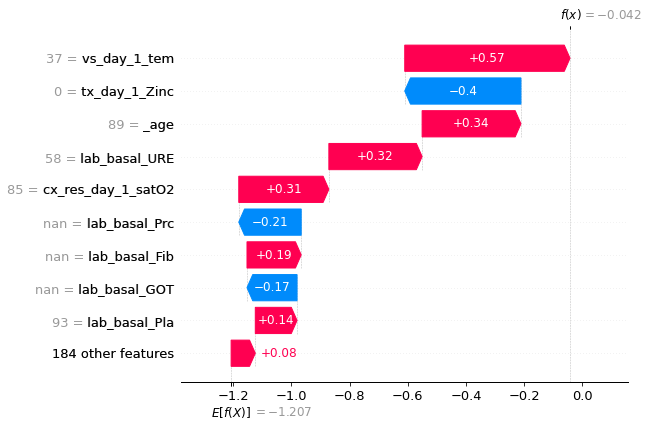

In [128]:
import shap

# explain the model's predictions using SHAP for one patient 
patient = 3
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(X)
print(pd.DataFrame( {'feature' : X.columns.values, 'value' : shap_values[patient].data})[33:49])

# visualize the first prediction's explanation
shap.plots.waterfall(shap_values[patient])


In [126]:

# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[patient])



In [103]:


# visualize all the training set predictions
shap.initjs()
shap.plots.force(explainer.expected_value, shap_values.values[:500], feature_names = X.columns)

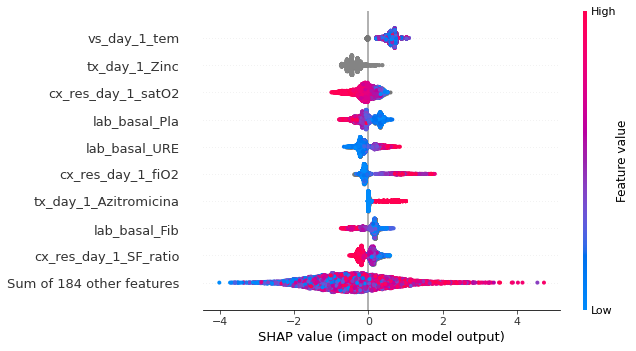

In [104]:
shap.plots.beeswarm(shap_values)

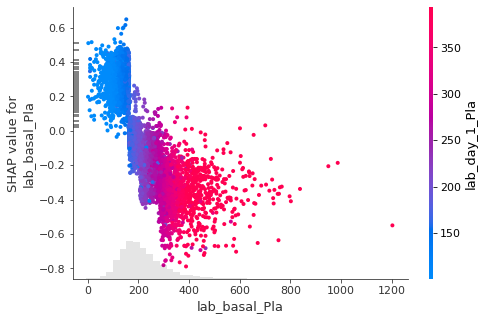

In [106]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,'lab_basal_Pla'], color=shap_values)

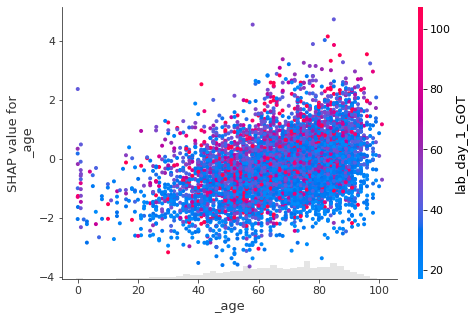

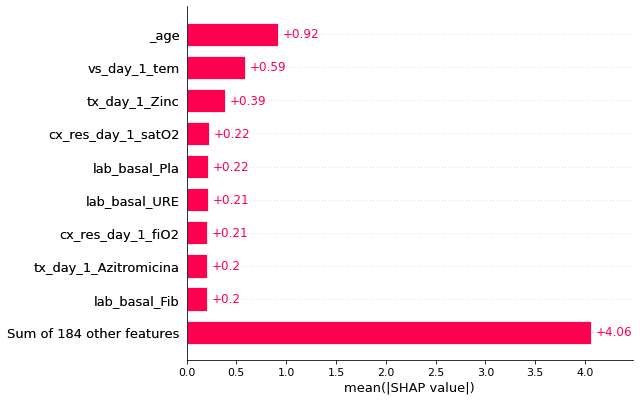

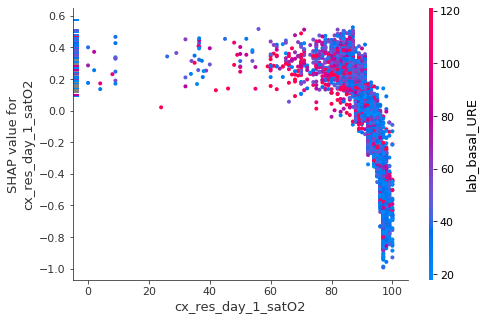

In [108]:


shap.plots.scatter(shap_values[:,'_age'], color=shap_values)

shap.plots.bar(shap_values)

shap.dependence_plot("cx_res_day_1_satO2", shap_values.values, X, interaction_index= 'lab_basal_URE')

#### Draw KM sv curves to proof positive tto effect on test set

In [678]:
new_X = ex[ex.index.isin(X_test.index)]


In [679]:
test_pool = Pool(new_X[x_vars], 
                new_X.y_binomial, 
                #weight = new_X.sIPTW,
                cat_features=['_gender'])


In [680]:
new_val = model.predict(test_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)

In [681]:
#list(zip(new_X.y_binomial,new_val))

In [682]:
new_X['pred'] = np.argmax(new_val, axis = 1)
new_X[['pred', 'y_binomial', 'y_who', 'tx_bin_Remdesivir']].head()


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,pred,y_binomial,y_who,tx_bin_Remdesivir
4620,0,1,0,False
8947,0,0,1,False
8948,0,0,1,False
8950,0,0,1,False
8951,0,0,1,False


In [683]:
km_df = new_X[(new_X.survival < 600 ) & (new_X.survival >= 0 ) & (new_X.pred == True)]
km_df.shape

(107, 1088)

In [684]:
#group = km_df.loc[km_df.tx_bin_Remdesivir == True].index
#group.size

(107, 1088)


It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  
It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           4.15 0.04      4.58

<lifelines.CoxPHFitter: fitted with 8.22818 total observations, 4.27873 right-censored observations>
             duration col = 'survival'
                event col = 'dead'
              weights col = 'sIPTW'
          robust variance = True
      baseline estimation = breslow
   number of observations = 8.22818
number of events observed = 3.94945
   partial log-likelihood = -5.51
         time fit was run = 2021-06-01 21:16:20 UTC

---
                    coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                                 
tx_bin_Remdesivir  -0.19       0.83       0.58            -1.34             0.95                 0.26                 2.59
charlson_sv        -0.00       1.00       0.01            -0.02             0.01                 0.98                 1.01
_age                0.05       1.06       0.02             0.02             0.09                 1.02                 1.09

                      z      p   -log2(p)
covariate                                
tx_bin_Remdesivir -0.33   0.74       0.43
charlson_sv       -0.69   0.49       1.03
_age               2.91 <0.005       8.09
---
Concordance = 0.66
Partial AIC = 17.01
log-likelihood ratio test = 2.07 on 3 df
-log2(p) of ll-ratio test = 0.84

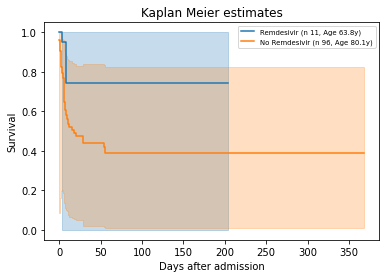

In [685]:
sv_tx_graph(km_df, 'Remdesivir', log = False )